In [1]:
import tensorflow as tf
from tensorflow.keras import models,layers
import matplotlib.pyplot as plt

2024-10-18 08:01:46.858705: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
Image_SIZE=256
BATCH_SIZE=32
CHANNELS=3
EPCOS=50

In [3]:
dataset=tf.keras.preprocessing.image_dataset_from_directory(
    "data",
    shuffle=True,
    image_size=(Image_SIZE,Image_SIZE),
    batch_size=BATCH_SIZE
)

Found 5547 files belonging to 50 classes.


In [4]:
class_names=dataset.class_names
class_names


['Abrus_precatorius_seeds',
 'Aegle_marmelos_fruit',
 'Ammomum_subulatum _fruit',
 'Anethum_graveolens_seed',
 'Areca_catecha_seed',
 'Butea_Monosperma_fruit',
 'Cassia_fistula_fruit',
 'Celastrus_paniculatus_seed',
 'Cessalpinia_crista_seed',
 'Citrallus_colocynthis_fruit',
 'Coriander_sativum_seed',
 'Croton_tiglium_seed',
 'Cuminum_cyminum_seed',
 'Elletaria_cardamomum_fruit',
 'Embelia_pterijiam cottam_fruit',
 'Embilica_officinalis_fruit',
 'Foeniculum_vulgare_seed',
 'Holoarrhena_antidysentrica_seed',
 'Macrotyloma_uniflorum_seeds',
 'Mucuna_pruriens_seed',
 'Myristica _fragrans_fruit',
 'Myristica_fragrans_Aril',
 'Nelumbo_nucifera_seed',
 'Nigella_sativa_seed',
 'Piper_cubeba_fruit',
 'Piper_nigrum_seed',
 'Pongamia_pinnata_seed',
 'Ricinus_cummunis_seeds',
 'Semicarpus_anacardium_fruit',
 'Sesamum_indicum_seed',
 'Strychnous_nuxvomica_seeds',
 'Strychnous_potatorum_seed',
 'Syzigium_cumini_seed',
 'Tachyspermum_amii_seed',
 'Terminalia_bellirica_fruit',
 'Trigonella_foenum-gra

In [5]:
len(dataset)


174

2024-10-18 08:02:16.392674: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


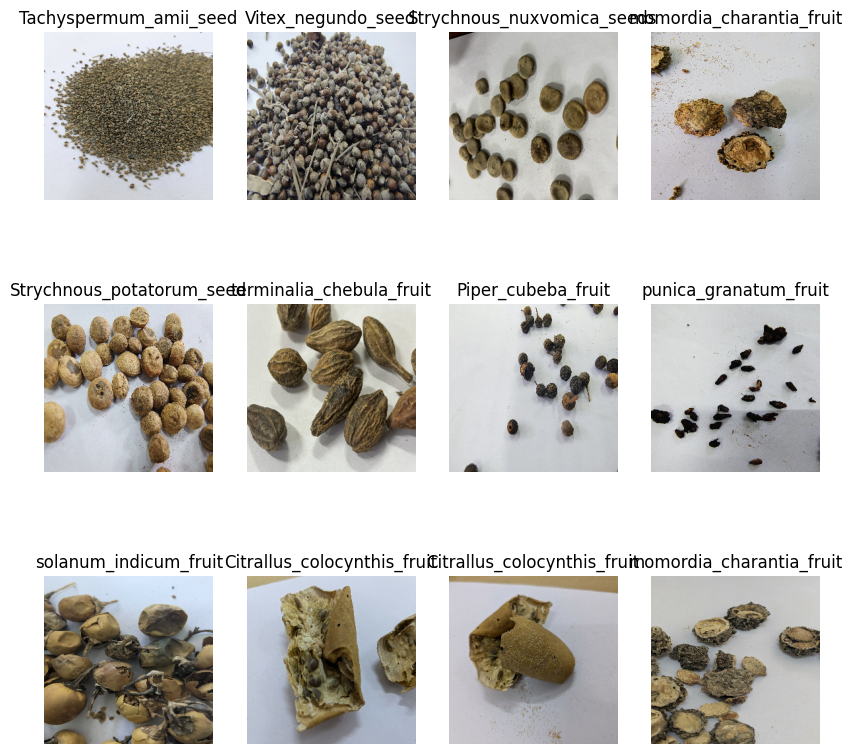

In [6]:
plt.figure(figsize=(10,10))
for image_batch,lable_batch in dataset.take(1):
    for i in range(12):
        ax=plt.subplot(3,4,i+1)
        plt.imshow(image_batch[i].numpy().astype("uint8"))
        plt.title(class_names[lable_batch[i]])
        plt.axis("off")

In [7]:
tran_size=0.8
len(dataset)*tran_size

139.20000000000002

In [8]:
train_ds=dataset.take(139)

len(train_ds)

139

In [9]:
test_ds=dataset.skip(139)
len(test_ds)

35

In [10]:
val_size=0.1
len(dataset)*val_size

17.400000000000002

In [11]:
val_ds=test_ds.take(17)
len(val_ds)

17

In [12]:
test_ds=test_ds.skip(17)
len(test_ds)

18

In [13]:
len(train_ds)

139

In [14]:
len(val_ds)


17

In [15]:
len(test_ds)


18

In [16]:
train_ds=train_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
test_ds=test_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
val_ds=val_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE    )

In [17]:
resize_and_rescale=tf.keras.Sequential([
   layers.Resizing(Image_SIZE, Image_SIZE),
    layers.Rescaling(1.0 / 255)
])

In [18]:
data_augmentation=resize_and_rescale=tf.keras.Sequential([
   layers.RandomFlip("horizontal_and_vertical"),
    layers.RandomRotation(1.0 / 255)
])
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

In [19]:
from keras import layers, models

# Define your preprocessing layers (make sure they are compatible with input shape)
resize_and_rescale = layers.Rescaling(1./255)  # Example resizing and rescaling
data_augmentation = layers.RandomFlip("horizontal_and_vertical")  # Example data augmentation

# Input shape defined in a separate layer
input_shape = (Image_SIZE, Image_SIZE, CHANNELS)  # Use shape excluding batch size
n_classes = 51

model = models.Sequential([
    layers.Input(shape=input_shape),  # Input layer to define the input shape
    resize_and_rescale,  # Apply resizing and scaling
    data_augmentation,    # Then apply data augmentation
    layers.Conv2D(32, (3, 3), activation="relu"),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(64, (3, 3), activation="relu"),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(128, (3, 3), activation="relu"),
    layers.MaxPooling2D((2, 2)),
    
    layers.Flatten(),
    layers.Dropout(0.5),
    layers.Dense(512, activation='relu'),
    layers.Dense(n_classes, activation='softmax')
])

# No need to call model.build() again, input shape is already defined


In [20]:
model.summary()


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ rescaling_1 (Rescaling)         │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ random_flip_1 (RandomFlip)      │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 254, 254, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 127, 127, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 125, 125, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 62, 62, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 60, 60, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 30, 30, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 115200)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 115200)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │    58,982,912 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 51)             │        26,163 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 59,102,323 (225.46 MB)

 Trainable params: 59,102,323 (225.46 MB)

 Non-trainable params: 0 (0.00 B)

In [21]:
model.compile(
    optimizer="adam",
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False, reduction=tf.keras.losses.Reduction.NONE),

    metrics=['accuracy']
)

In [22]:
hstory=model.fit(
    train_ds,
    epochs=20,
    batch_size=BATCH_SIZE,
    verbose=1,
    validation_data=val_ds
)

Epoch 1/20


2024-10-18 08:03:50.803450: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:450] ShuffleDatasetV3:14: Filling up shuffle buffer (this may take a while): 11 of 1000
2024-10-18 08:04:10.097699: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:450] ShuffleDatasetV3:14: Filling up shuffle buffer (this may take a while): 29 of 1000
2024-10-18 08:04:29.906138: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:450] ShuffleDatasetV3:14: Filling up shuffle buffer (this may take a while): 47 of 1000
2024-10-18 08:04:40.335854: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:450] ShuffleDatasetV3:14: Filling up shuffle buffer (this may take a while): 56 of 1000
2024-10-18 08:04:50.725300: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:450] ShuffleDatasetV3:14: Filling up shuffle buffer (this may take a while): 65 of 1000
2024-10-18 08:05:10.055998: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:450] ShuffleDatasetV3:14: Filling up shuffle buffer (this may take a while

139/139 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.0395 - loss: 4.1052

2024-10-18 08:13:43.871771: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:450] ShuffleDatasetV3:20: Filling up shuffle buffer (this may take a while): 1 of 1000
2024-10-18 08:13:53.994179: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:450] ShuffleDatasetV3:20: Filling up shuffle buffer (this may take a while): 10 of 1000
2024-10-18 08:14:02.008047: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:480] Shuffle buffer filled.


139/139 ━━━━━━━━━━━━━━━━━━━━ 633s 3s/step - accuracy: 0.0398 - loss: 4.1013 - val_accuracy: 0.1507 - val_loss: 2.7936
Epoch 2/20
139/139 ━━━━━━━━━━━━━━━━━━━━ 299s 2s/step - accuracy: 0.2366 - loss: 2.5148 - val_accuracy: 0.3493 - val_loss: 1.9610
Epoch 3/20
139/139 ━━━━━━━━━━━━━━━━━━━━ 300s 2s/step - accuracy: 0.4258 - loss: 1.8642 - val_accuracy: 0.4007 - val_loss: 1.8630
Epoch 4/20
139/139 ━━━━━━━━━━━━━━━━━━━━ 301s 2s/step - accuracy: 0.5185 - loss: 1.4893 - val_accuracy: 0.5037 - val_loss: 1.5453
Epoch 5/20
139/139 ━━━━━━━━━━━━━━━━━━━━ 298s 2s/step - accuracy: 0.5979 - loss: 1.2420 - val_accuracy: 0.5827 - val_loss: 1.2591
Epoch 6/20
139/139 ━━━━━━━━━━━━━━━━━━━━ 312s 2s/step - accuracy: 0.6504 - loss: 1.0873 - val_accuracy: 0.6103 - val_loss: 1.1586
Epoch 7/20
139/139 ━━━━━━━━━━━━━━━━━━━━ 300s 2s/step - accuracy: 0.7334 - loss: 0.8611 - val_accuracy: 0.6618 - val_loss: 1.0046
Epoch 8/20
139/139 ━━━━━━━━━━━━━━━━━━━━ 300s 2s/step - accuracy: 0.7808 - loss: 0.7195 - val_accuracy: 0.615

In [23]:
acc = hstory.history['accuracy']
val_acc = hstory.history['val_accuracy']

loss = hstory.history['loss']
val_loss = hstory.history['val_loss']


ValueError: x and y must have same first dimension, but have shapes (50,) and (20,)

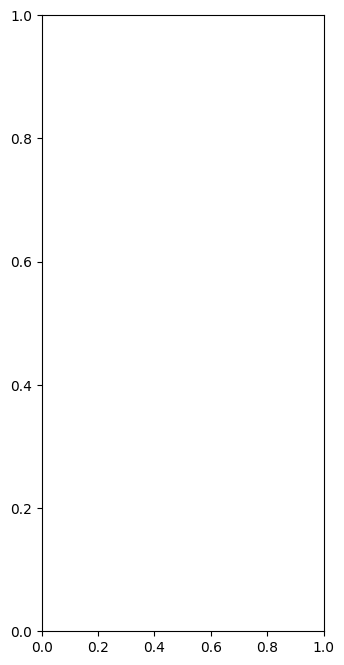

In [24]:
plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(range(EPCOS), acc, label='Training Accuracy')
plt.plot(range(EPCOS), val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(range(EPCOS), loss, label='Training Loss')
plt.plot(range(EPCOS), val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

2024-10-18 10:04:47.271875: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:450] ShuffleDatasetV3:17: Filling up shuffle buffer (this may take a while): 1 of 1000
2024-10-18 10:04:57.326875: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:450] ShuffleDatasetV3:17: Filling up shuffle buffer (this may take a while): 10 of 1000
2024-10-18 10:05:05.242959: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:480] Shuffle buffer filled.


first image to predict
actual label: Macrotyloma_uniflorum_seeds
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 629ms/step
predicted label: Macrotyloma_uniflorum_seeds


2024-10-18 10:05:05.958504: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


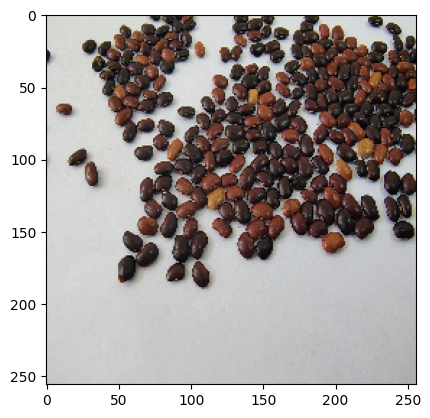

In [25]:
import numpy as np
for images_batch, labels_batch in test_ds.take(1):
    
    first_image = images_batch[0].numpy().astype('uint8')
    first_label = labels_batch[0].numpy()
    
    print("first image to predict")
    plt.imshow(first_image)
    print("actual label:",class_names[first_label])
    
    batch_prediction = model.predict(images_batch)
    print("predicted label:",class_names[np.argmax(batch_prediction[0])])

In [26]:
def predict(model, img):
    img_array = tf.keras.preprocessing.image.img_to_array(images[i].numpy())
    img_array = tf.expand_dims(img_array, 0)

    predictions = model.predict(img_array)

    predicted_class = class_names[np.argmax(predictions[0])]
    confidence = round(100 * (np.max(predictions[0])), 2)
    return predicted_class, confidence

In [27]:
def predict(model, img):
    img_array = tf.keras.preprocessing.image.img_to_array(img)  # Remove .numpy() here
    img_array = tf.expand_dims(img_array, 0)  # Add batch dimension

    predictions = model.predict(img_array)

    predicted_class = class_names[np.argmax(predictions[0])]
    confidence = round(100 * (np.max(predictions[0])), 2)
    return predicted_class, confidence


In [28]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

# Initialize a dictionary to hold one image sample for each class
class_samples = {class_name: None for class_name in class_names}

# Collect one sample image from each class
for images, labels in test_ds:
    for img, label in zip(images, labels.numpy()):  # Convert labels to numpy
        class_name = class_names[label]
        if class_samples[class_name] is None:  # If no sample has been collected for this class
            class_samples[class_name] = img  # Store the image
        if all(sample is not None for sample in class_samples.values()):
            break  # Exit if all classes have one sample
    if all(sample is not None for sample in class_samples.values()):
        break  # Exit if all classes have one sample

# Set up the plot with 3 columns
num_classes = len(class_samples)
plt.figure(figsize=(30, (num_classes // 3) * 10))  # Adjust the figure size based on the number of rows (height scales accordingly)
count = 0  # Counter for subplots

# Plot one sample for each class
for class_name, img in class_samples.items():
    ax = plt.subplot((num_classes // 3) + 1, 3, count + 1)  # 3 columns per row
    
    # Resize the image to a larger size for better visibility
    img_resized = tf.image.resize(img, [600, 600])  # Resize to 600x600 pixels
    
    plt.imshow(img_resized.numpy().astype("uint8"))
    
    predicted_class, confidence = predict(model, img)  # Get predictions
    plt.title(f"{class_name}\nPredicted: {predicted_class}\nConfidence: {confidence}%", fontsize=20)  # Increase font size
    plt.axis("off")
    count += 1

plt.tight_layout()
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━

In [31]:
model_version = 1
model.save(f"model_{model_version}.keras")
model.save(f"model_{model_version}.h5")


In [33]:
!pip3 install -U scikit-learn scipy matplotlib


error: externally-managed-environment

× This environment is externally managed
╰─> To install Python packages system-wide, try brew install
    xyz, where xyz is the package you are trying to
    install.
    
    If you wish to install a Python library that isn't in Homebrew,
    use a virtual environment:
    
    python3 -m venv path/to/venv
    source path/to/venv/bin/activate
    python3 -m pip install xyz
    
    If you wish to install a Python application that isn't in Homebrew,
    it may be easiest to use 'pipx install xyz', which will manage a
    virtual environment for you. You can install pipx with
    
    brew install pipx
    
    You may restore the old behavior of pip by passing
    the '--break-system-packages' flag to pip, or by adding
    'break-system-packages = true' to your pip.conf file. The latter
    will permanently disable this error.
    
    If you disable this error, we STRONGLY recommend that you additionally
    pass the '--user' flag to pip, or set 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━

2024-10-18 10:16:35.970458: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


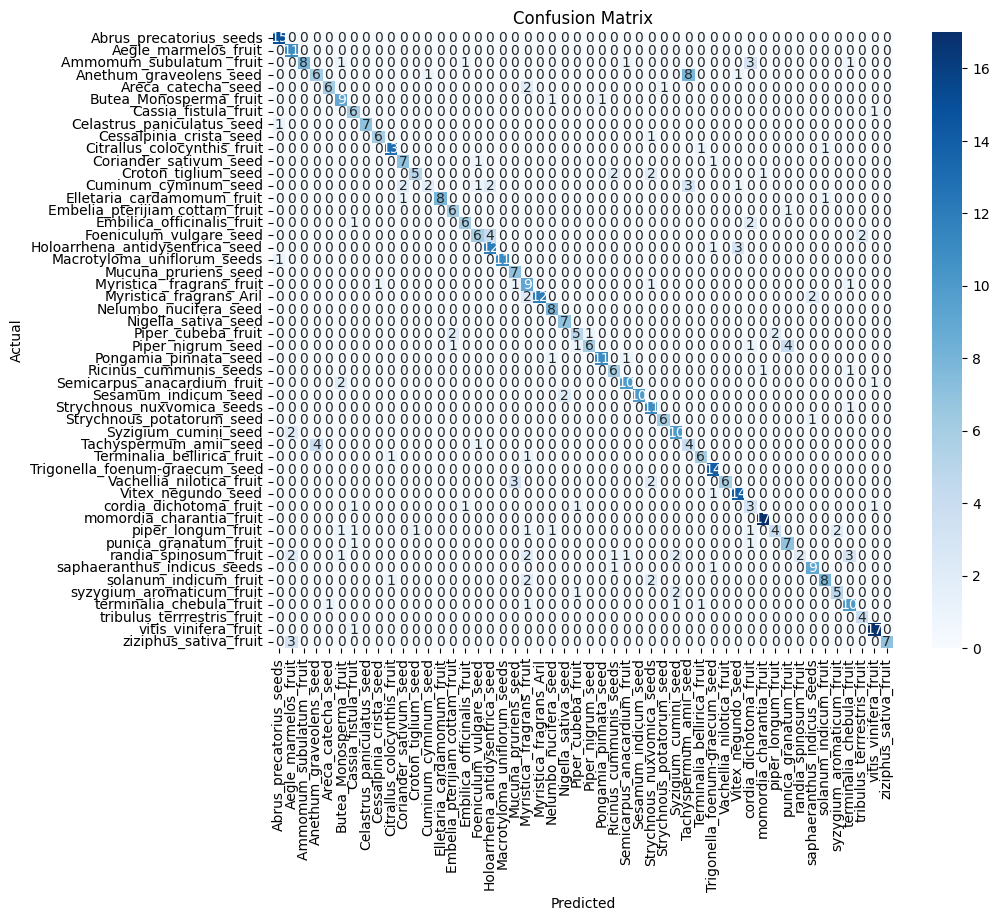

Accuracy: 0.73
Precision: 0.77
Recall: 0.73
F1 Score: 0.72
Specificity: 0.99
Top-1 Accuracy: 0.03


In [35]:
import tensorflow as tf
import numpy as np

import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score, accuracy_score
import seaborn as sns

def predict(model, img):
    # Convert image to array if it isn't already
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0)  # Create a batch of one image

    predictions = model.predict(img_array)
    predicted_class = class_names[np.argmax(predictions[0])]
    confidence = round(100 * (np.max(predictions[0])), 2)
    return predicted_class, confidence

# Assuming class_names, model, and test_ds are already defined

# Step 1: Collect predictions and true labels
y_true = []
y_pred = []

for images, labels in test_ds:
    for img, label in zip(images, labels):
        predicted_class, _ = predict(model, img)
        y_true.append(class_names[label.numpy()])
        y_pred.append(predicted_class)

# Convert lists to numpy arrays
y_true = np.array(y_true)
y_pred = np.array(y_pred)

# Step 2: Compute the confusion matrix
cm = confusion_matrix(y_true, y_pred, labels=class_names)

# Step 3: Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

# Step 4: Compute metrics
accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')

# Specificity Calculation
def specificity(cm):
    tn = np.diag(cm).sum() - np.diag(cm)
    fp = cm.sum(axis=0) - np.diag(cm)
    spec = tn / (tn + fp)
    return np.mean(spec)

spec = specificity(cm)

# Top-1 Accuracy (For k=1 here, as a common example)
# Adjust this according to your top-k needs, for k=1 we compare top prediction
top_k_accuracy = np.mean([1 if class_names[np.argmax(predictions[0])] == true_class else 0 for true_class, predictions in zip(y_true, y_pred)])

# Print metrics
print(f"Accuracy: {accuracy:.2f}")
print(f"Precision: {precision:.2f}")
print(f"Recall: {recall:.2f}")
print(f"F1 Score: {f1:.2f}")
print(f"Specificity: {spec:.2f}")

print(f"Top-1 Accuracy: {top_k_accuracy:.2f}")
